In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import numpy as np
from sklearn.manifold import TSNE
from umap.umap_ import UMAP
from pacmap import PaCMAP
from trimap import TRIMAP
import warnings
import pandas as pd
# Hide warning messages
warnings.filterwarnings('ignore')

# Dataset generation

## Functions that generates different figures

In [2]:
# sphere
def generate_n_dimensional_sphere(num_dimensions, num_points, radius=1):
    
    # Generate normal distributed points.
    points = np.random.randn(num_dimensions, num_points)

    # Normalize the points so that they are on the surface of the sphere.
    points /= np.linalg.norm(points, axis=0)
    
    points *= radius
    return points.T

In [3]:
# ball
def generate_n_dimensional_ball(num_dimensions, num_points, radius=1):

    # Generate points on the surface of the sphere.
    points = np.random.randn(num_dimensions, num_points)
    points /= np.linalg.norm(points, axis=0)

    # Generate a random scaling factor for each point.
    scales = np.random.rand(num_points) ** (1 / num_dimensions)

    # Scale the points by the scaling factors so they are inside the sphere.
    points *= scales * radius

    return points.T

In [4]:
# torus
def generate_n_dimensional_torus(n_dimensions, n_points, R=2, r=1):
    """
    Creates an n-dimensional torus.
    
    Parameters:
    n_dimensions : int
        The number of dimensions for the torus. Must be greater than or equal to 2.
    n_points : int
        The number of points.
    R : float
        The distance from the center of the tube to the center of the torus.
    r : float
        The radius of the tube (distance from the center of the tube to the torus surface).
        
    Returns:
    numpy.ndarray
        The n-dimensional points of the torus.
    """
    
    assert n_dimensions >= 2, "Number of dimensions must be greater than or equal to 2."

    # generate n_points random angles for each dimension
    angles = np.random.uniform(0, 2*np.pi, (n_points, n_dimensions))

    # calculate the n-dimensional points on the torus
    coordinates = []
    for i in range(n_dimensions):
        if i == 0:
            coordinate = (R + r * np.cos(angles[:, 1])) * np.cos(angles[:, 0])
        elif i == 1:
            coordinate = (R + r * np.cos(angles[:, 1])) * np.sin(angles[:, 0])
        else:
            coordinate = r * np.sin(angles[:, i])
        coordinates.append(coordinate)

    return np.array(coordinates).T


In [15]:
# ball in sphere in sphere
def generate_ball_in_sphere_in_sphere(num_dimensions, num_points, radii=[1, 50, 100]):
    
    ball_1 = generate_n_dimensional_ball(num_dimensions, num_points, radii[0])
    sphere_1 = generate_n_dimensional_sphere(num_dimensions, num_points, radii[1])
    sphere_2 = generate_n_dimensional_sphere(num_dimensions, num_points, radii[2])
    
    # Create labels for each figure
    ball_1_labels = np.full((num_points,), 'ball')
    sphere_1_labels = np.full((num_points,), 'sphere 1')
    sphere_2_labels = np.full((num_points,), 'sphere 2')
    
    # Concatenate data and labels
    data = np.concatenate((ball_1, sphere_1, sphere_2))
    labels = np.concatenate((ball_1_labels, sphere_1_labels, sphere_2_labels))
    
    return data, labels

In [22]:
# torus in sphere
def generate_torus_in_sphere(num_dimensions, num_points, radii=[5, 50, 100]):
    
    torus = generate_n_dimensional_torus(num_dimensions, num_points, radii[1], radii[0])
    sphere = generate_n_dimensional_sphere(num_dimensions, num_points, radii[2])

     # Create labels for each figure
    torus_labels = np.full((num_points,), 'torus')
    sphere_labels = np.full((num_points,), 'sphere')
    
    # Concatenate data and labels
    data = np.concatenate((torus, sphere))
    labels = np.concatenate((torus_labels, sphere_labels))
    
    return data, labels

In [27]:
# torus in sphere in torus
def generate_torus_in_sphere_in_torus(num_dimensions, num_points, radii=[70, 50, 35, 5]):

    torus1 = generate_n_dimensional_torus(num_dimensions, num_points, radii[0], radii[3])
    sphere_1 = generate_n_dimensional_sphere(num_dimensions, num_points, radii[2])
    torus2 = generate_n_dimensional_torus(num_dimensions, num_points, radii[1], radii[3])

    # Create labels for each figure
    torus_1_labels = np.full((num_points,), 'torus1')
    sphere_labels = np.full((num_points,), 'sphere')
    torus_2_labels = np.full((num_points,), 'torus2')

    # Concatenate data and labels
    data = np.concatenate((torus1, sphere_1, torus2))
    labels = np.concatenate((torus_1_labels, sphere_labels, torus_2_labels))

    return data, labels

In [28]:
# generate 2D array of datasets with different number of dimensions and datasize
# variable type_of_dataset tells which type of dataset should be created
# size of the 2D array is data_size X num_of_dimensions
def generate_datasets(number_of_dimensions, data_size, type_of_dataset):
    # create an empty 2D array to store the datasets
    datasets = np.empty((len(data_size), len(number_of_dimensions)), dtype=object)
    labels = np.empty((len(data_size), len(number_of_dimensions)), dtype=object)
    # 1 means first ddataset - ball in sphere in sphere
    if type_of_dataset == 1:
        for i, size in enumerate(data_size):
            for j, dim in enumerate(number_of_dimensions):
                dataset, label = generate_ball_in_sphere_in_sphere(dim, size)
                datasets[i, j] = dataset
                labels[i, j] = label
     # 2 means second ddataset - torus in sphere
    elif type_of_dataset == 2:
        for i, size in enumerate(data_size):
            for j, dim in enumerate(number_of_dimensions):
                dataset, label = generate_torus_in_sphere(dim, size)
                datasets[i, j] = dataset
                labels[i, j] = label
    elif type_of_dataset == 3:
        for i, size in enumerate(data_size):
            for j, dim in enumerate(number_of_dimensions):
                dataset, label = generate_torus_in_sphere_in_torus(dim, size)
                datasets[i, j] = dataset
                labels[i, j] = label
    else: 
        return None
    return datasets, labels

## Functions to visualise figures

In [17]:
# visualisation of 3d figures
# one color
def visualize_3d_figure(points, title='3 dimensional points'):

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(points[:, 0], points[:, 1], points[:, 2])

    # Set the same scale for all axes
    max_range = np.array([points[:, 0].max()-points[:, 0].min(), points[:, 1].max()-points[:, 1].min(), points[:, 2].max()-points[:, 2].min()]).max()
    Xb = 0.5*max_range*np.mgrid[-1:2:2,-1:2:2,-1:2:2][0].flatten() + 0.5*(points[:, 0].max()+points[:, 0].min())
    Yb = 0.5*max_range*np.mgrid[-1:2:2,-1:2:2,-1:2:2][1].flatten() + 0.5*(points[:, 1].max()+points[:, 1].min())
    Zb = 0.5*max_range*np.mgrid[-1:2:2,-1:2:2,-1:2:2][2].flatten() + 0.5*(points[:, 2].max()+points[:, 2].min())

    # Comment or uncomment following both lines to test the fake bounding box:
    for xb, yb, zb in zip(Xb, Yb, Zb):
        ax.plot([xb], [yb], [zb], 'w')

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')

    plt.show()


In [18]:
# visualisation of 3d figures in figures
# two color
def visualize_3d_figure_in_figure(points, title='3 dimensional points'):
    n = int(points.shape[0] / 3)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter3D(points[:n, 0], points[:n, 1], points[:n, 2])
    ax.scatter3D(points[-n:, 0], points[-n:, 1], points[-n:, 2], color = 'pink', alpha = 0.3)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title(title)
    
    plt.show()

In [19]:
# visualisation of 3d figure in figure in figure
# three colors
def visualize_3d_figure_in_figure_in_figure(points, title='3 dimensional points'):
    n = int(points.shape[0] / 3)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter3D(points[:n, 0], points[:n, 1], points[:n, 2])
    ax.scatter3D(points[n:-n, 0], points[n:-n, 1], points[n:-n, 2], color = 'green', alpha = 0.3)
    ax.scatter3D(points[-n:, 0], points[-n:, 1], points[-n:, 2], color = 'pink', alpha = 0.3)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title(title)
    
    plt.show()


## Generation of different variances of datasets

In [20]:
number_of_dimensions = [3, 5, 10, 15]
number_of_points = [1000, 5000, 10000, 25000]

In [29]:
# generation of array of datasets with labels: ball in sphere in sphere with different number of dimensions and number of points
datasets_1, labels_1 = generate_datasets(number_of_dimensions, number_of_points, 1)

# generation of array of datasets: torus in sphere in sphere with different number of dimensions and number of points
datasets_2, labels_2 = generate_datasets(number_of_dimensions, number_of_points, 2)

# generation of array of datasets: torus in sphere in torus with different number of dimensions and number of points
datasets_3, labels_3 = generate_datasets(number_of_dimensions, number_of_points, 3)

In [13]:
d, l = generate_datasets(number_of_dimensions, number_of_points, 2)

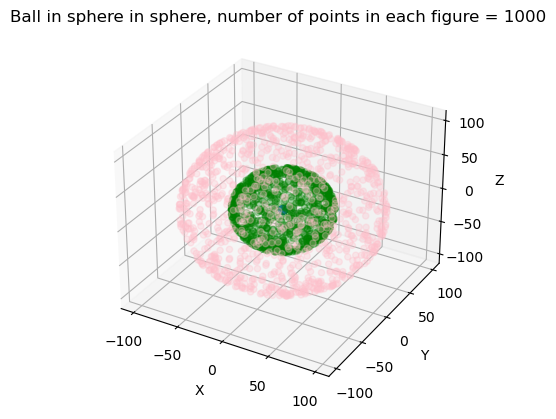

In [14]:
visualize_3d_figure_in_figure_in_figure(datasets_1[0, 0], title='Ball in sphere in sphere, number of points in each figure = 1000')

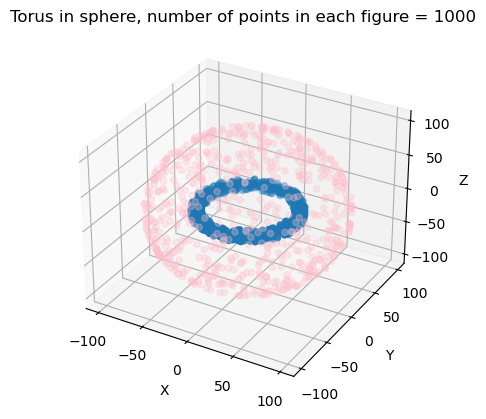

In [15]:
visualize_3d_figure_in_figure(datasets_2[0, 0], title='Torus in sphere, number of points in each figure = 1000')

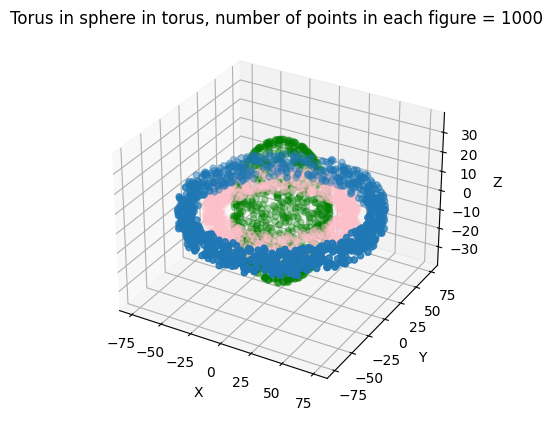

In [59]:
visualize_3d_figure_in_figure_in_figure(datasets_3[0, 0], title='Torus in sphere in torus, number of points in each figure = 1000')

# Functions of algorithms that reduces dimensionality

In [30]:
def tsne_visualisation(points, labels, title='TSNE'):
    
    # Apply t-SNE for dimensionality reduction
    tsne = TSNE()
    reduced_points = tsne.fit_transform(points)
    
    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels,  legend = 'full')
    plt.xlabel('t-SNE Dimension 1', fontsize = 14)
    plt.ylabel('t-SNE Dimension 2', fontsize= 14)
    plt.title(title, fontsize = 18)
    return reduced_points

In [31]:
def umap_visualisation(points, labels, title = 'UMAP'):
    
    # Apply t-SNE for dimensionality reduction
    umap = UMAP()
    reduced_points = umap.fit_transform(points)

    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels, legend = 'full')
    plt.xlabel('UMAP Dimension 1',fontsize = 14)
    plt.ylabel('UMAP Dimension 2',fontsize= 14)
    plt.title(title, fontsize = 18)
    return reduced_points

In [32]:
def trimap_visualisation(points, labels, title = 'PaCMAP'):
    
    # Apply TriMAP for dimensionality reduction
    trimap = TRIMAP()
    reduced_points = trimap.fit_transform(points)
    
    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels, legend = 'full')
    plt.xlabel('TriMAP Dimension 1', fontsize = 14)
    plt.ylabel('TriMAP Dimension 2', fontsize= 14)
    plt.title(title, fontsize = 18)
    return reduced_points

In [33]:
def pacmap_visualisation(points, labels, title = 'PaCMAP'):
    
    # Apply PaCMAP for dimensionality reduction
    pacmap = PaCMAP()
    reduced_points = pacmap.fit_transform(points)
    
    # Plot the reduced points in 2D
    sns.scatterplot(x = reduced_points[:,0], y = reduced_points[:,1], hue = labels,  legend = 'full')
    plt.xlabel('PaCMAP Dimension 1', fontsize = 14)
    plt.ylabel('PaCMAP Dimension 2', fontsize = 14)
    plt.title(title, fontsize = 18)
    return reduced_points

In [34]:
def ivhd_visualisation(points, title = 'IVHD'):
    pass

In [35]:
# matrix plot visualisation on one plot with different parameters od datasize and dimensionality
# y axis is data size
# x axis i dimensionality
def matrix_plot_visualisation(datasets, labels, dimensionality_reduction_func, plot_title):
    
    plt.subplots(figsize=(30, 30))
    plt.subplots_adjust(hspace=0.3, wspace=0.3) 
    k = 0
    num_rows = datasets.shape[0]
    num_cols = datasets.shape[1]
    
    # create an empty 2D array to store datasets of reduced points
    datasets_reduced = np.empty((num_rows, num_cols), dtype=object)

    for i in range(num_rows):
        for j in range(num_cols):
            dataset = datasets[i][j]
            label = labels[i][j]
            k+=1
            plt.subplot(num_rows, num_cols, k)
            datasets_reduced[i][j] = dimensionality_reduction_func(dataset, label, title = "Number of points: " + str(dataset.shape[0]) + "\n Number of dimensions: " + str(dataset.shape[1]))
            
    plt.suptitle(plot_title, fontsize = 40)
    
    return datasets_reduced

# Implementing dimensionality reduction allgorithms on datasets

## Dataset 0

Redukcja wymiarów na podstawowych figurach
Do wywalenia potem, tlyko tak podglądowo

## Sphere

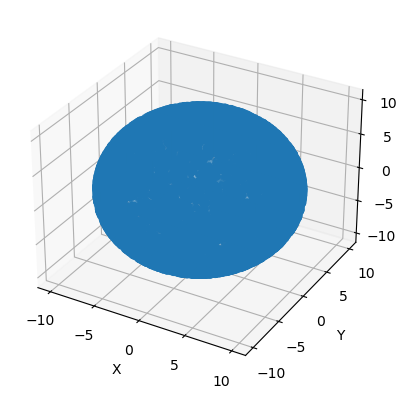

In [112]:
sphere = generate_n_dimensional_sphere(3, 10000, 10)
visualize_3d_figure(sphere, title = '3 dimensional sphere, number of points = 1000')

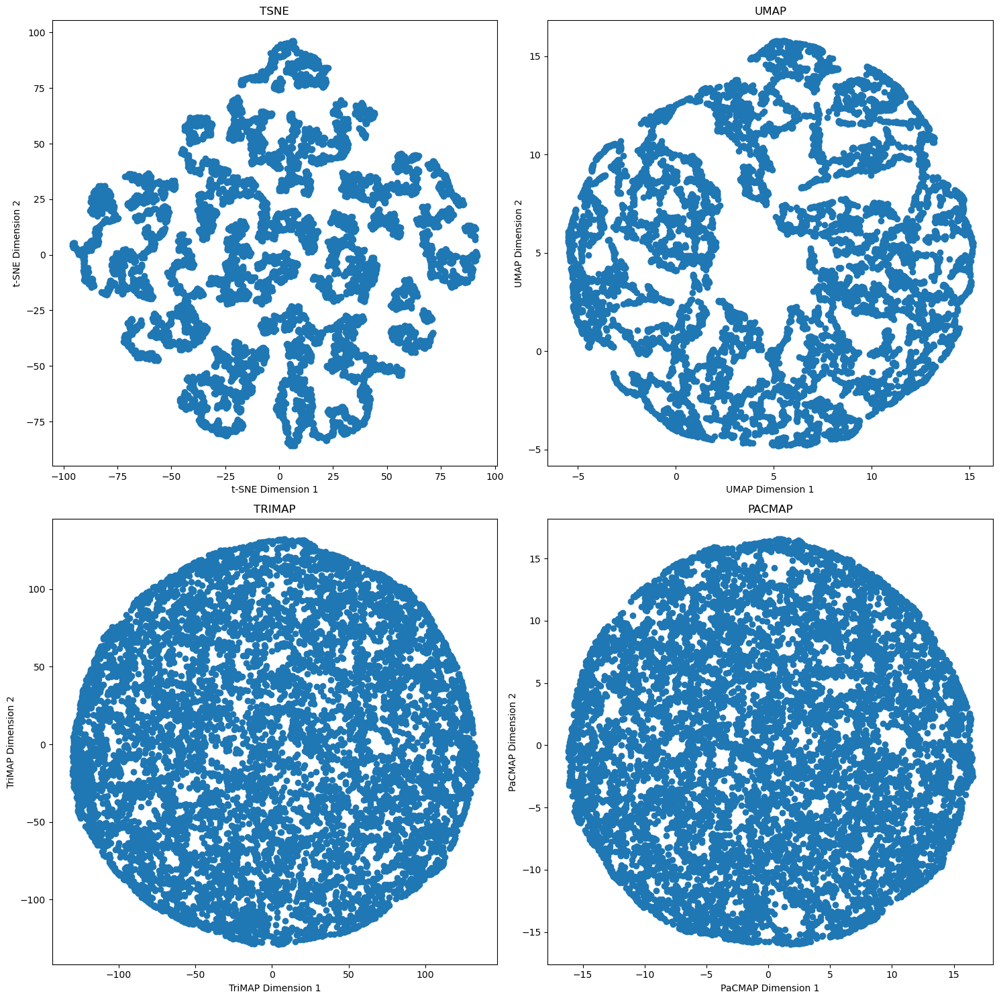

In [113]:
plt.subplots(figsize=(15, 15))
plt.subplot(2, 2, 1)
tsne_visualisation(sphere, title='TSNE')
plt.subplot(2, 2, 2)
umap_visualisation(sphere, title='UMAP')
plt.subplot(2, 2, 3)
trimap_visualisation(sphere, title='TRIMAP')
plt.subplot(2, 2, 4)
pacmap_visualisation(sphere, title='PACMAP')

plt.tight_layout()
plt.show()

## Ball

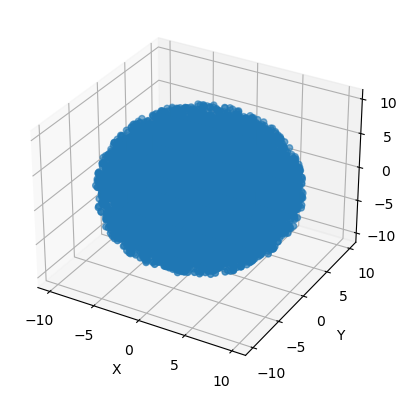

In [114]:
ball = generate_n_dimensional_ball(3, 10000, 10)
visualize_3d_figure(ball, title = '3 dimensional ball, number of points = 1000')

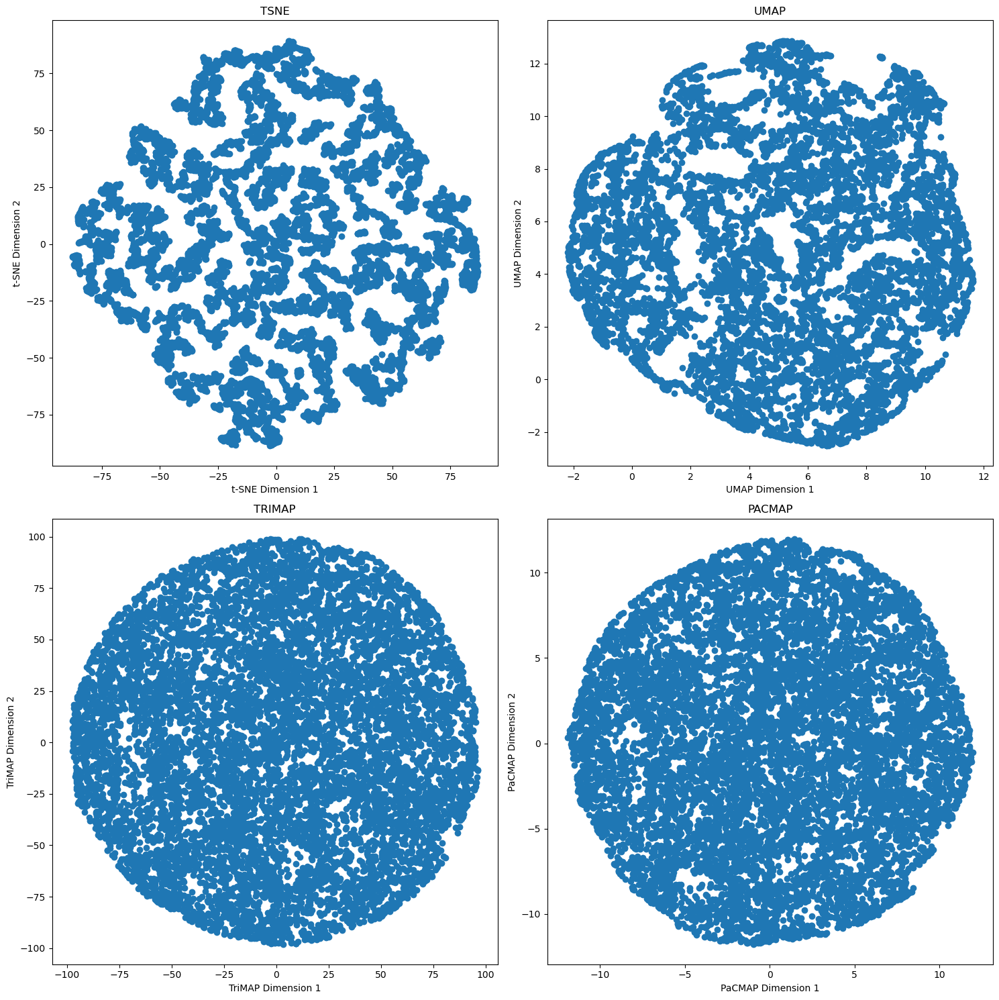

In [115]:
plt.subplots(figsize=(15, 15))
plt.subplot(2, 2, 1)
tsne_visualisation(ball, title='TSNE')
plt.subplot(2, 2, 2)
umap_visualisation(ball, title='UMAP')
plt.subplot(2, 2, 3)
trimap_visualisation(ball, title='TRIMAP')
plt.subplot(2, 2, 4)
pacmap_visualisation(ball, title='PACMAP')

plt.tight_layout()
plt.show()

Miedzy kulą a sfera nie ma jakiejs duzej roznicy w wizualizacji

## Torus

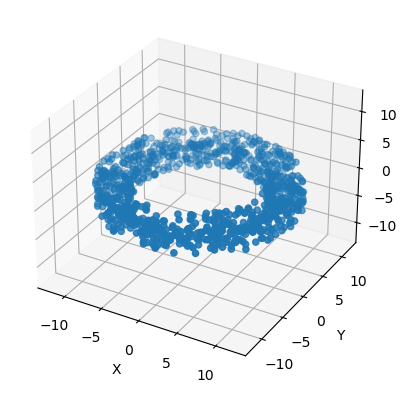

In [119]:
torus = generate_n_dimensional_torus(3, 1000, 10, 2)
visualize_3d_figure(torus, title = '3 dimensional torus, number of points = 1000')

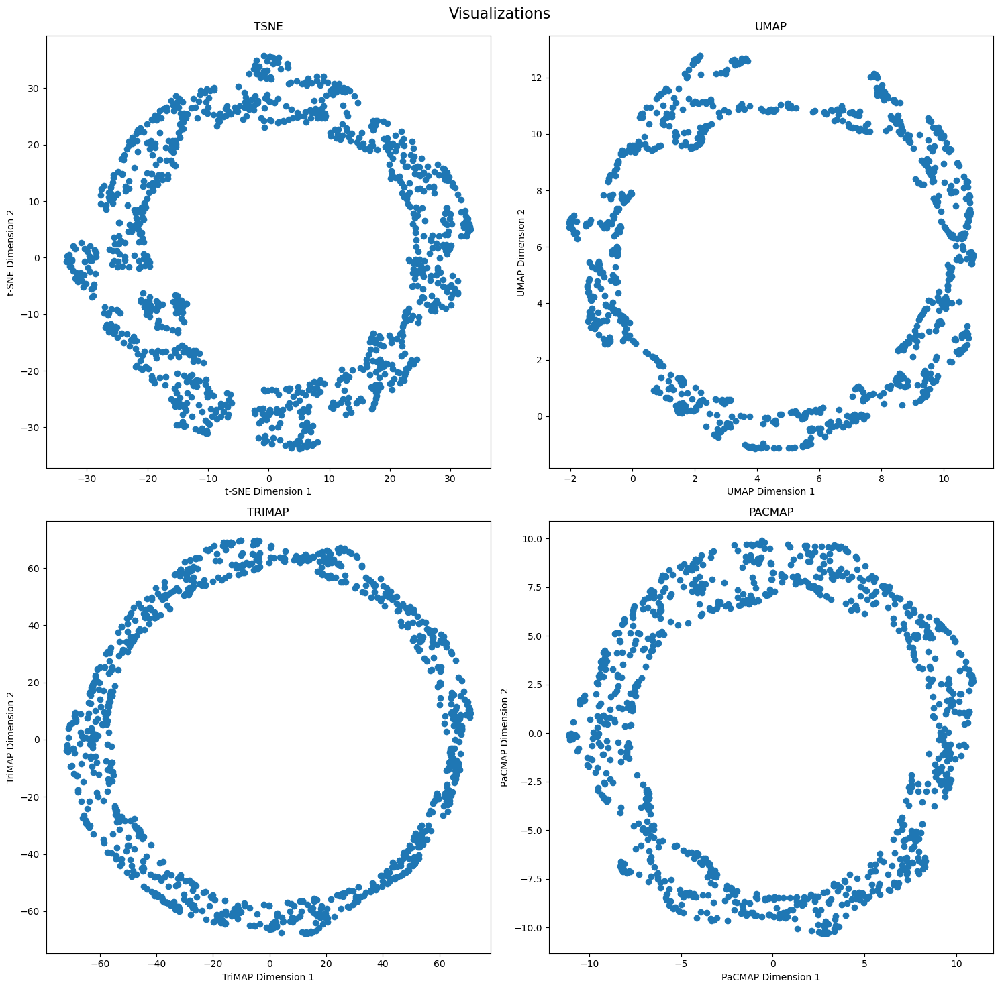

In [121]:
plt.subplots(figsize=(15, 15))
plt.subplot(2, 2, 1)
tsne_visualisation(torus, title='TSNE')
plt.subplot(2, 2, 2)
umap_visualisation(torus, title='UMAP')
plt.subplot(2, 2, 3)
trimap_visualisation(torus, title='TRIMAP')
plt.subplot(2, 2, 4)
pacmap_visualisation(torus, title='PACMAP')
plt.suptitle('Visualizations', fontsize = 16)
plt.tight_layout()
plt.show()

## Dataset 1 - Ball in sphere in sphere

### TSNE

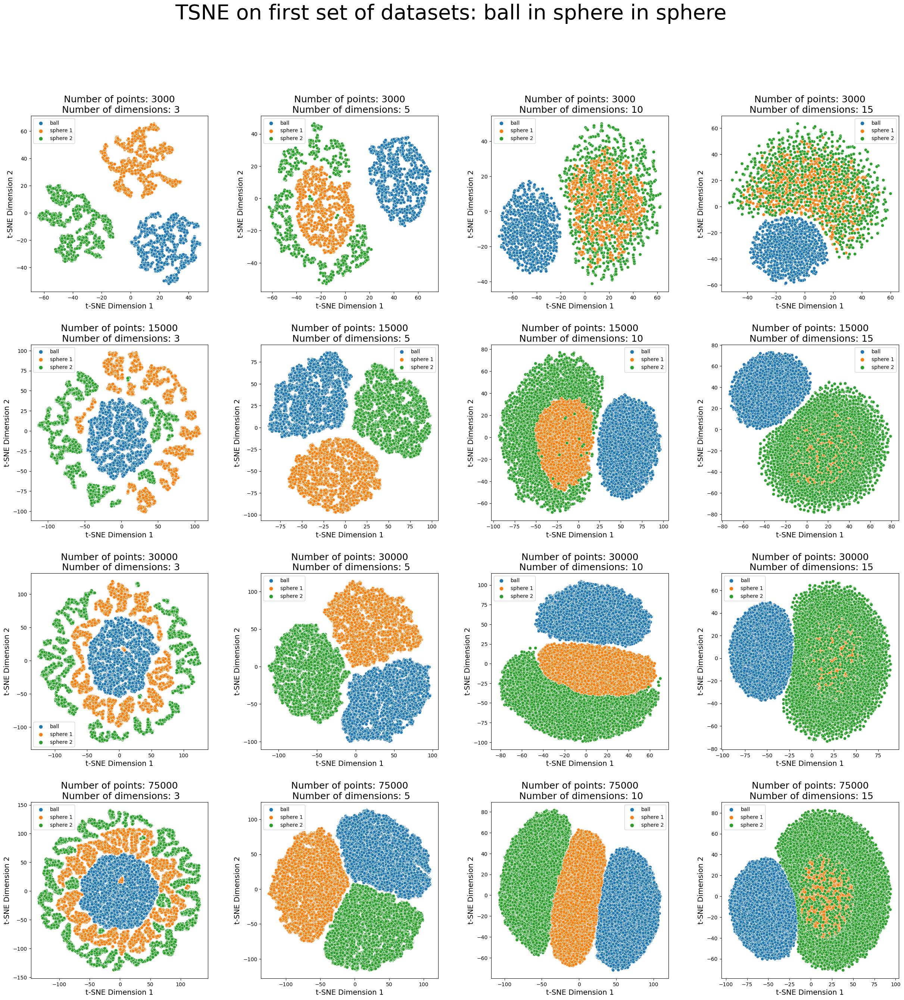

In [22]:
datasets_1_tsne = matrix_plot_visualisation(datasets_1, labels_1, tsne_visualisation, "TSNE on first set of datasets: ball in sphere in sphere")

### UMAP

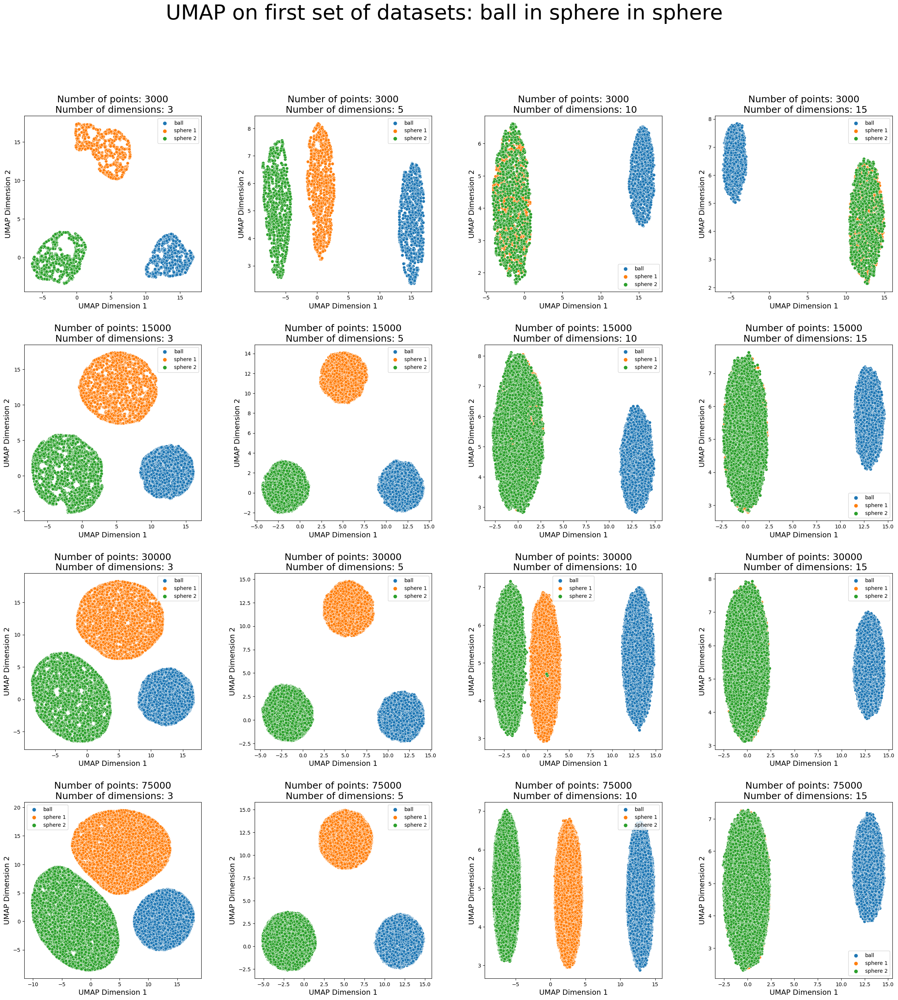

In [23]:
datasets_1_umap = matrix_plot_visualisation(datasets_1, labels_1, umap_visualisation, "UMAP on first set of datasets: ball in sphere in sphere")

### TriMAP

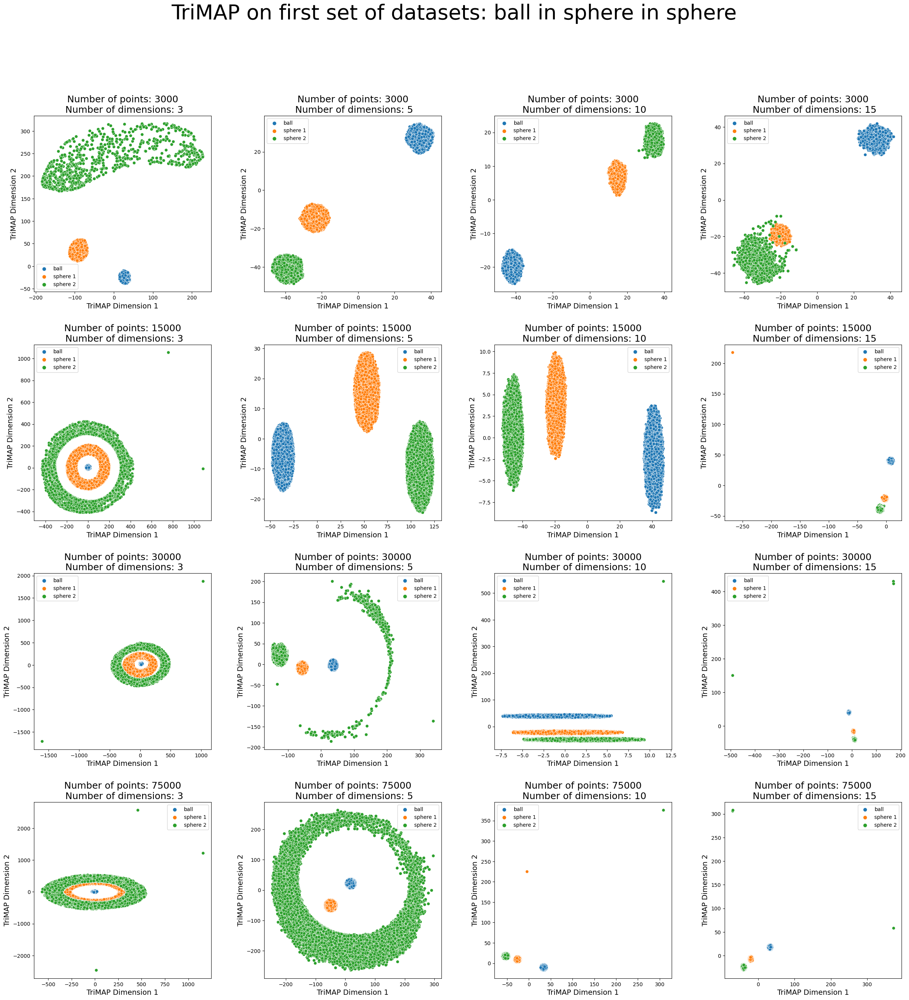

In [24]:
datasets_1_trimap = matrix_plot_visualisation(datasets_1, labels_1, trimap_visualisation, "TriMAP on first set of datasets: ball in sphere in sphere")

### PaCMAP

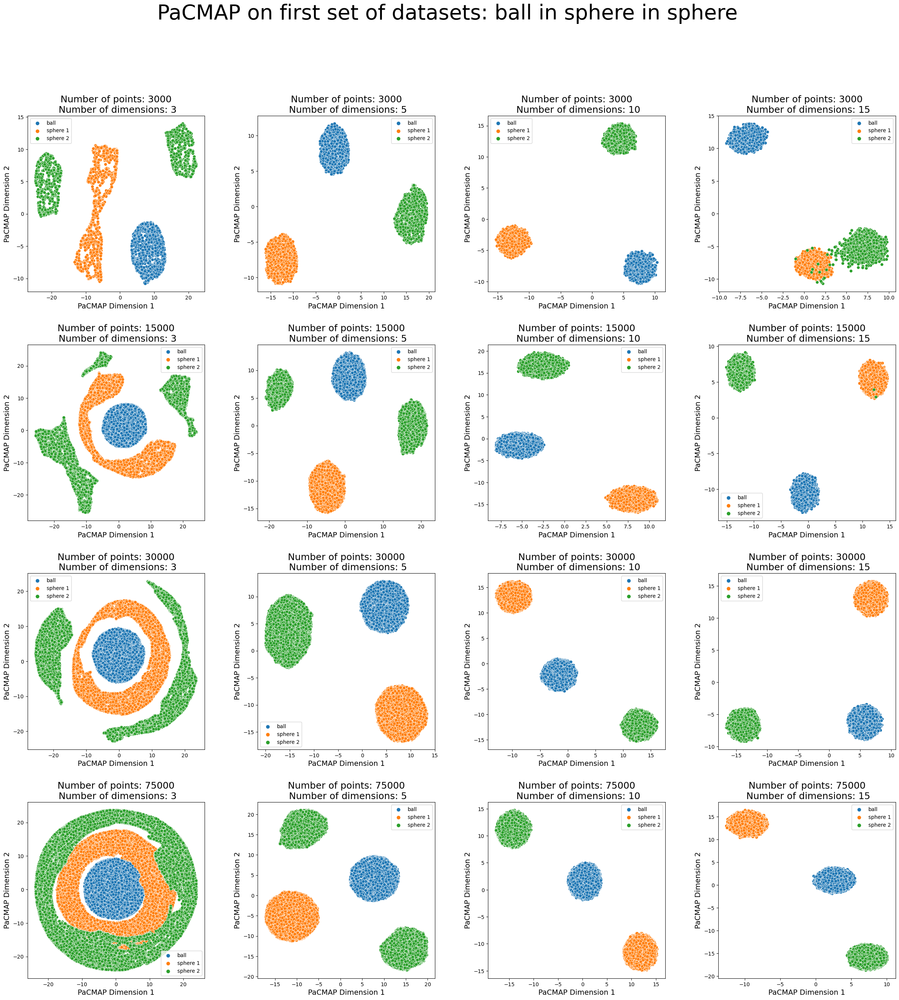

In [25]:
datasets_1_pacmap = matrix_plot_visualisation(datasets_1, labels_1, pacmap_visualisation, "PaCMAP on first set of datasets: ball in sphere in sphere")

## Dataset 2 - Torus in sphere

### TSNE

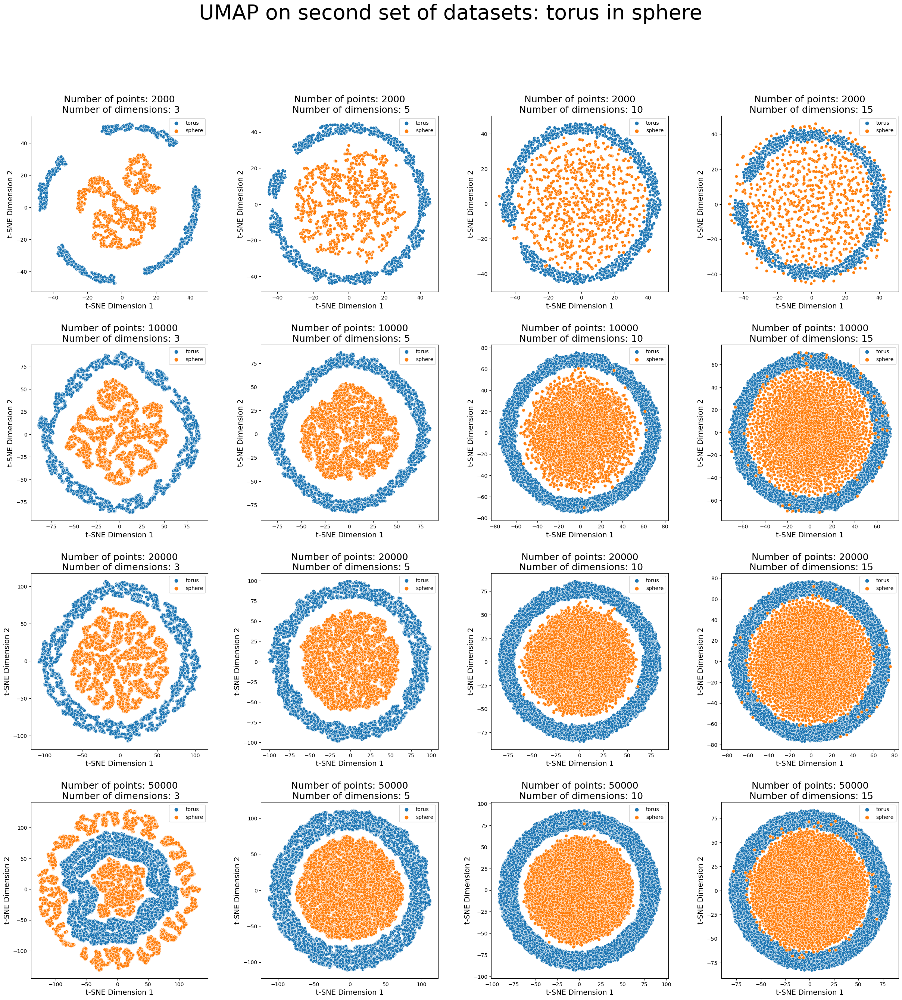

In [26]:
datasets_2_tsne = matrix_plot_visualisation(datasets_2, labels_2, tsne_visualisation, "UMAP on second set of datasets: torus in sphere")

### UMAP

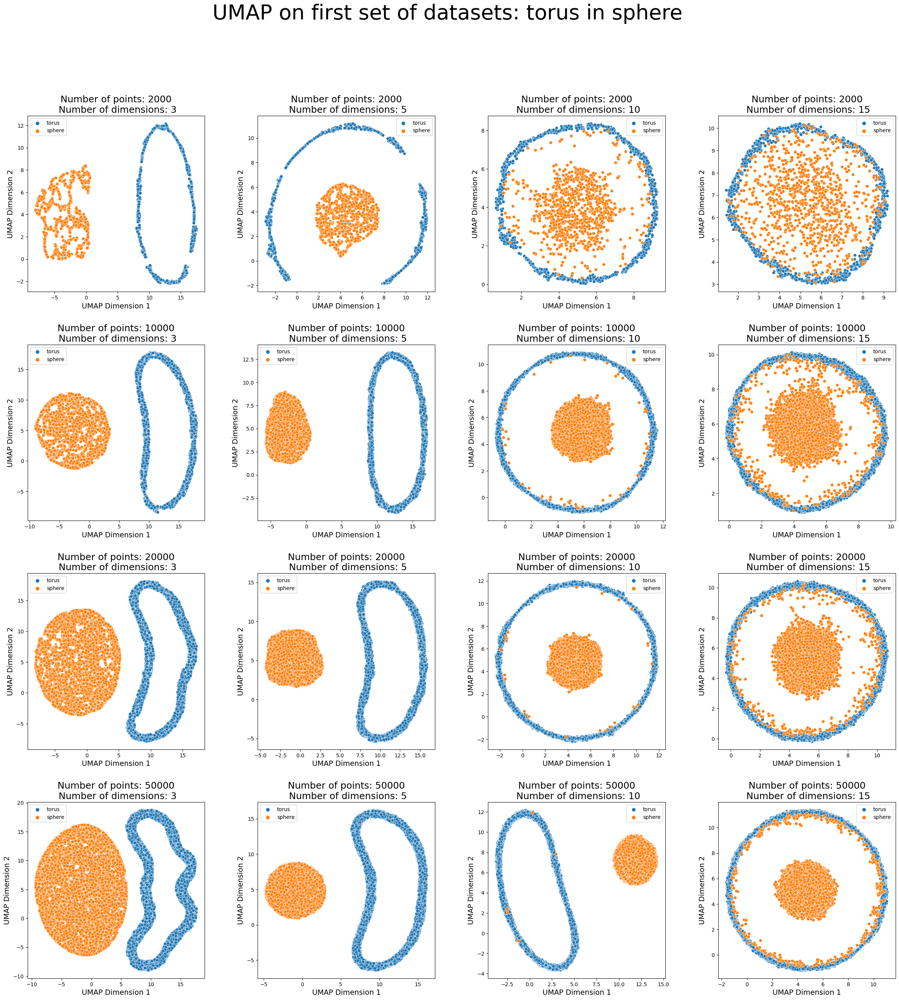

In [27]:
datasets_2_umap = matrix_plot_visualisation(datasets_2, labels_2, umap_visualisation, "UMAP on first set of datasets: torus in sphere")

### TriMAP

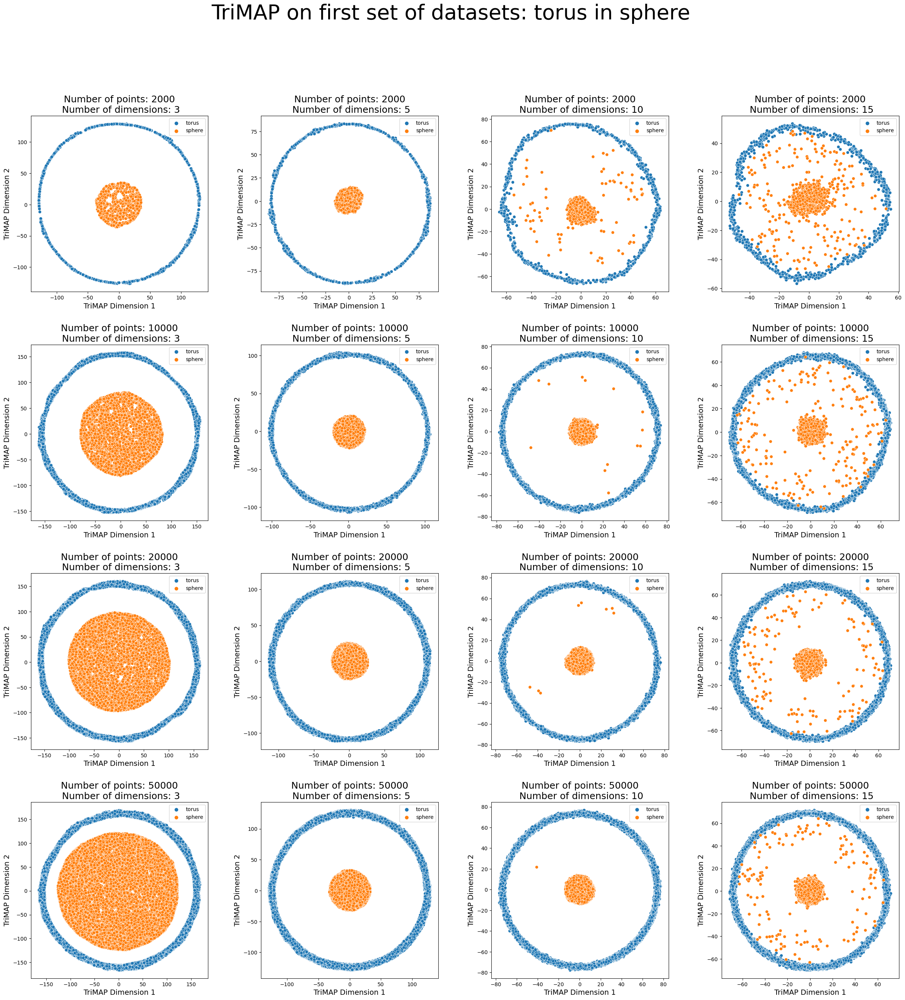

In [28]:
datasets_2_trimap = matrix_plot_visualisation(datasets_2, labels_2, trimap_visualisation, "TriMAP on first set of datasets: torus in sphere")

### PaCMAP

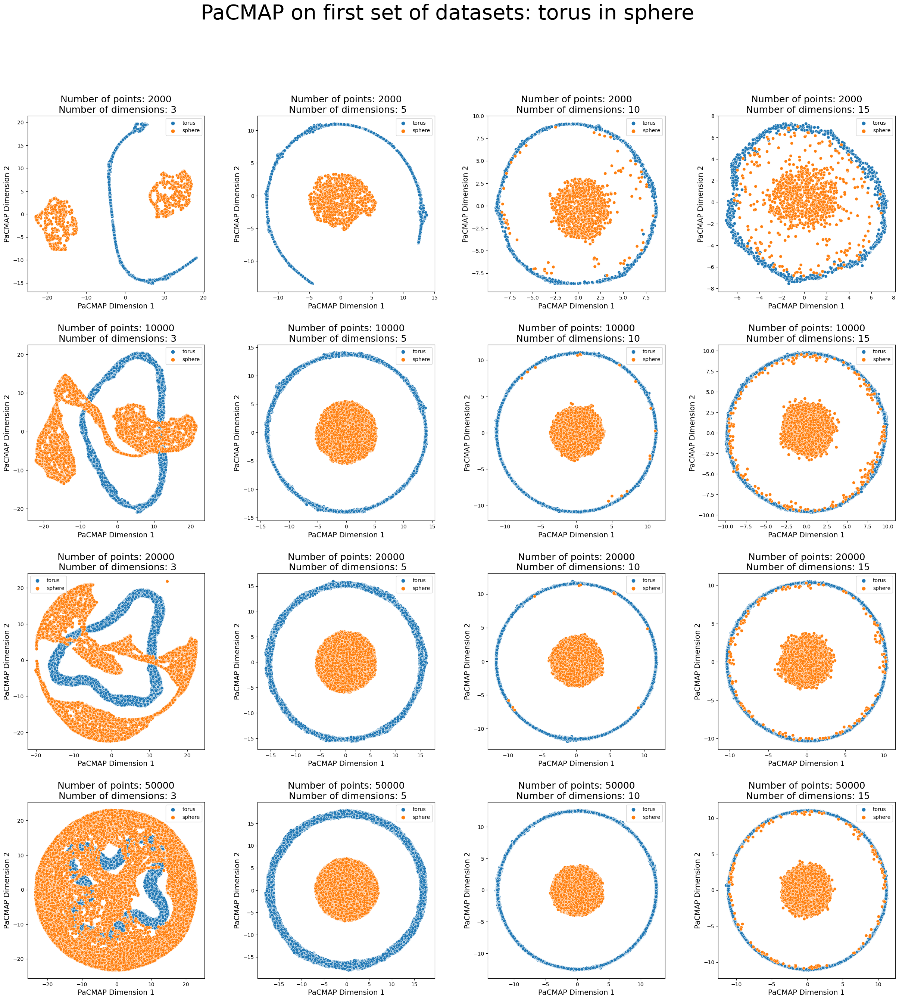

In [29]:
datasets_2_pacmap = matrix_plot_visualisation(datasets_2, labels_2, pacmap_visualisation, "PaCMAP on first set of datasets: torus in sphere")

Wnioski: <br/>
+ Znowu jest tak że dla 300000 punktow dla mniejszej wymairowości radzi sobie gorzje

## Dataset 3 - torus in sphere in torus

### TSNE

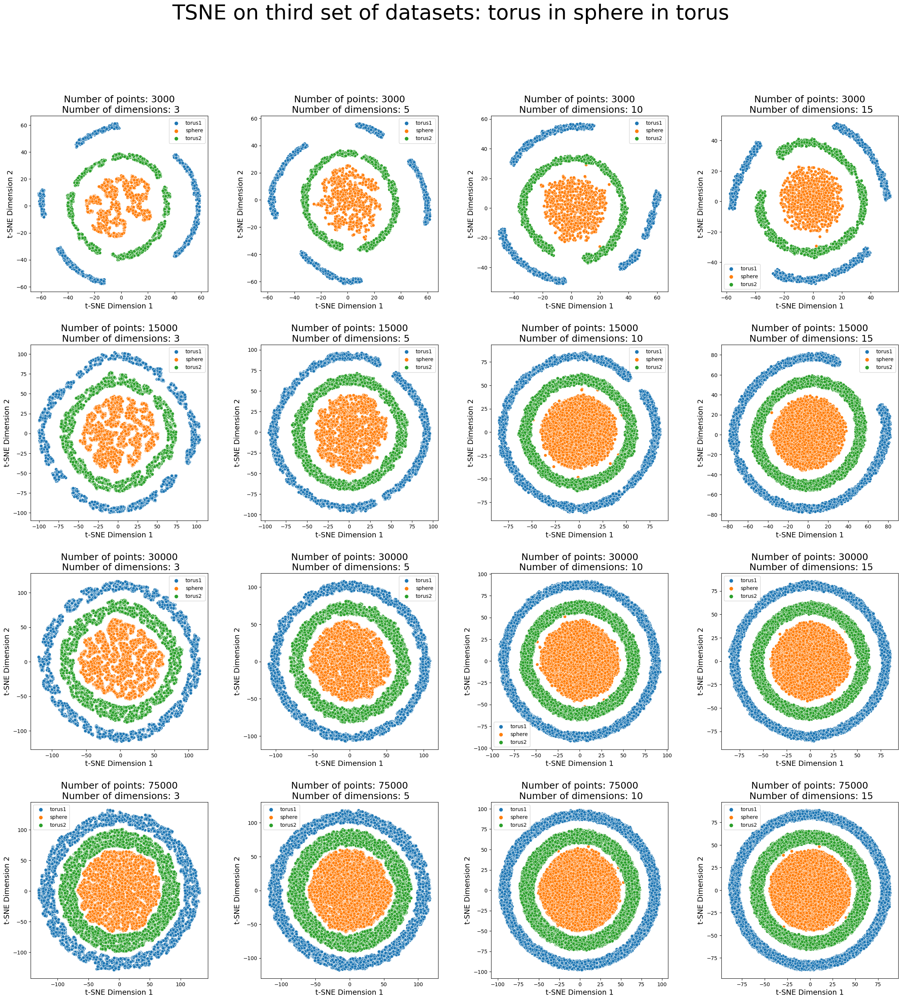

In [37]:
datasets_3_tsne = matrix_plot_visualisation(datasets_3, labels_3, tsne_visualisation, "TSNE on third set of datasets: torus in sphere in torus")

## UMAP

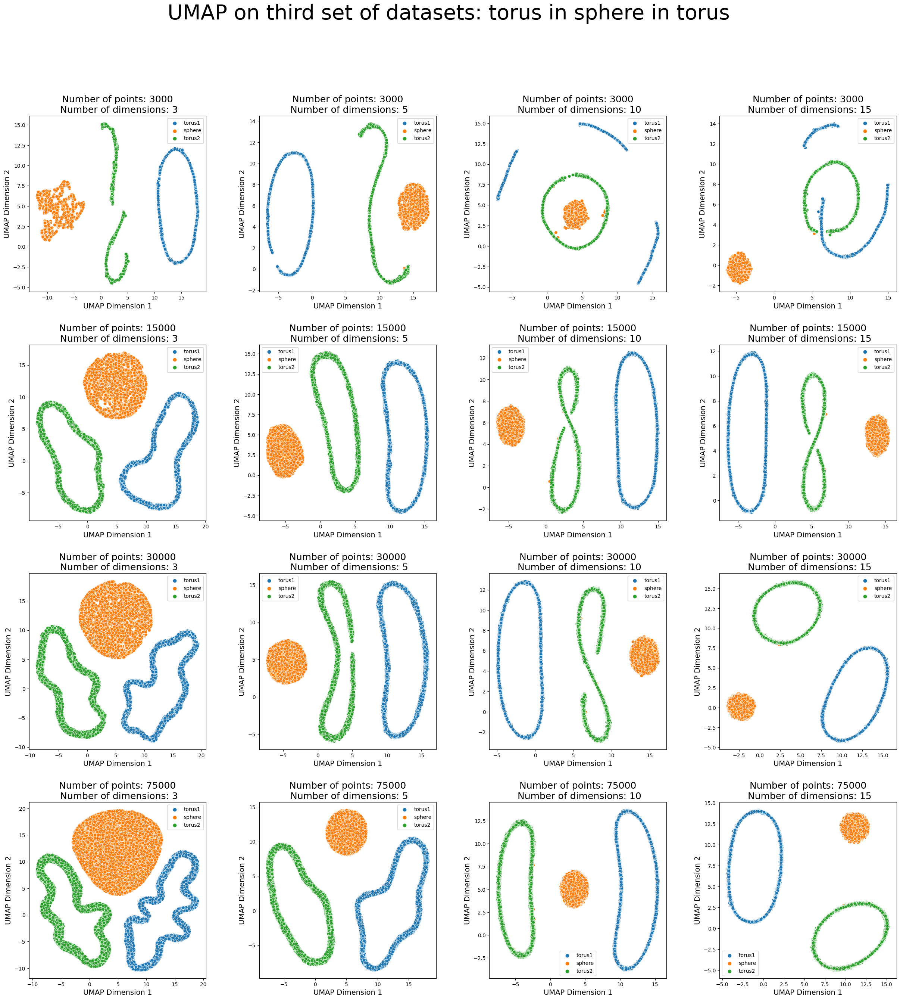

In [38]:
datasets_3_umap = matrix_plot_visualisation(datasets_3, labels_3, umap_visualisation, "UMAP on third set of datasets: torus in sphere in torus")

### TriMAP

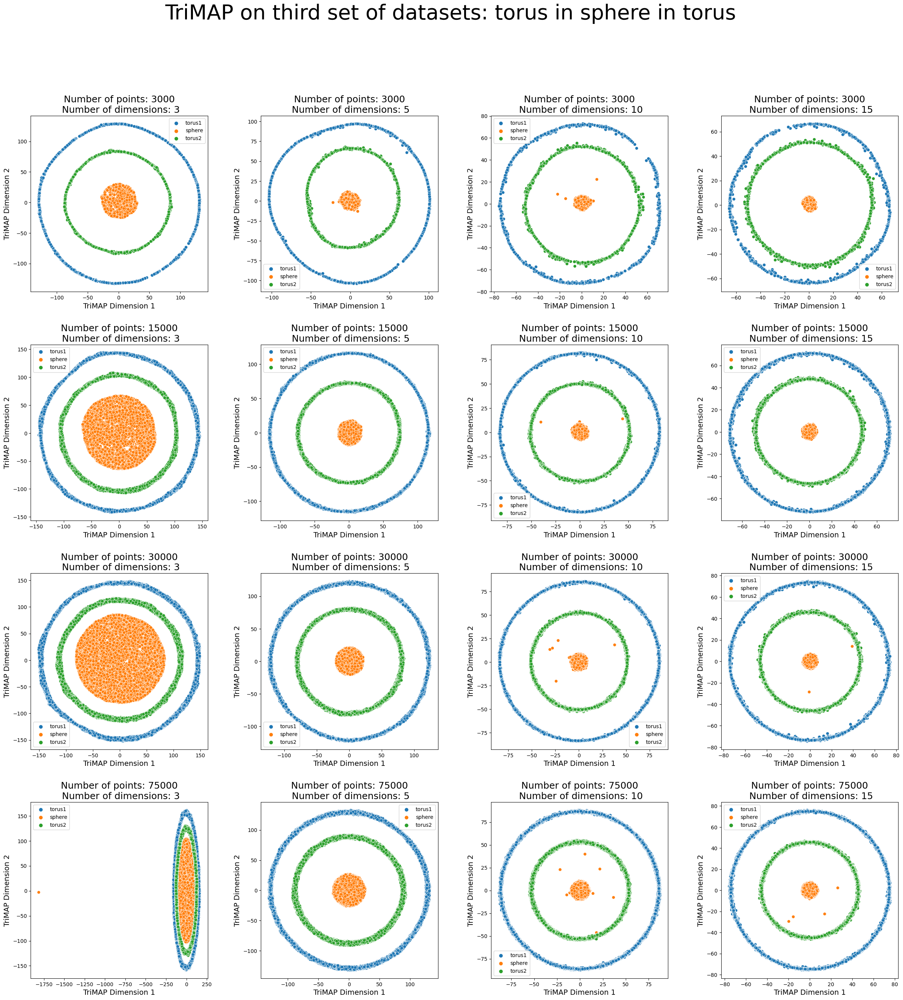

In [39]:
datasets_3_trimap = matrix_plot_visualisation(datasets_3, labels_3, trimap_visualisation, "TriMAP on third set of datasets: torus in sphere in torus")

### PACMAP

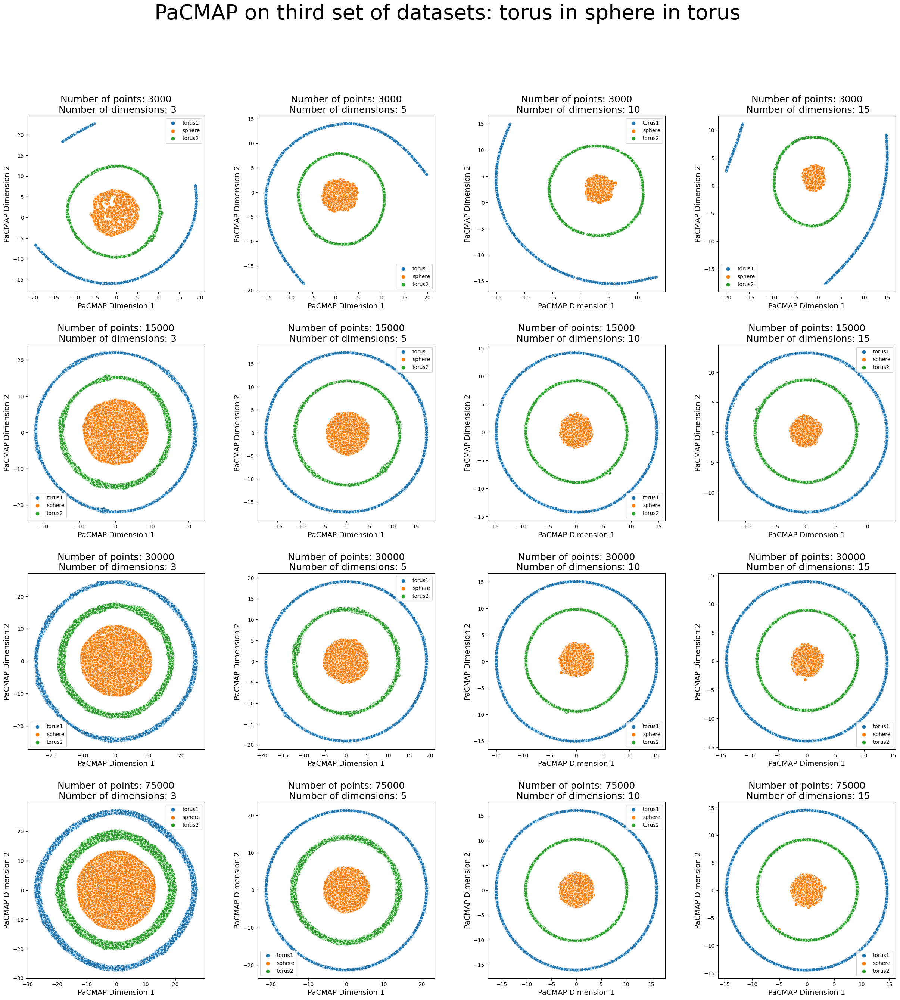

In [40]:
datasets_3_pacmap = matrix_plot_visualisation(datasets_3, labels_3, pacmap_visualisation, "PaCMAP on third set of datasets: torus in sphere in torus")

## Writing embedded datasets to csv file

Run this if you do not want to compile whole code

In [41]:
def save_embedded_datasets(reduced_datasets, algorithm_name, dataset_name):
    for i, points in enumerate(number_of_points):
        for j, dim in enumerate(number_of_dimensions):
            name_of_dataset = 'data/' + dataset_name + '_' + str(dim) + '_dimensions_' + str(points * 3) + '_points' + algorithm_name + '.csv'
            df = pd.DataFrame(reduced_datasets[i][j])
            df.to_csv(name_of_dataset) 

In [42]:
save_embedded_datasets(datasets_1_tsne, 'tsne', 'datasets_1')
save_embedded_datasets(datasets_1_umap, 'umap', 'datasets_1')
save_embedded_datasets(datasets_1_trimap, 'trimap', 'datasets_1')
save_embedded_datasets(datasets_1_pacmap, 'pacmap', 'datasets_1')

save_embedded_datasets(datasets_2_tsne, 'tsne', 'datasets_2')
save_embedded_datasets(datasets_2_umap, 'umap', 'datasets_2')
save_embedded_datasets(datasets_2_trimap, 'trimap', 'datasets_2')
save_embedded_datasets(datasets_2_pacmap, 'pacmap', 'datasets_2')

save_embedded_datasets(datasets_3_tsne, 'tsne', 'datasets_3')
save_embedded_datasets(datasets_3_umap, 'umap', 'datasets_3')
save_embedded_datasets(datasets_3_trimap, 'trimap', 'datasets_3')
save_embedded_datasets(datasets_3_pacmap, 'pacmap', 'datasets_3')

## Loading data from csv file


In [43]:
def load_data_from_csv(algorithm_name, dataset_name):
    reduced_datasets = np.empty((len(number_of_points), len(number_of_dimensions)), dtype=object)
    for i, points in enumerate(number_of_points):
        for j, dim in enumerate(number_of_dimensions):
            name_of_dataset = 'data/' + dataset_name + '_' + str(dim) + '_dimensions_' + str(points * 3) + '_points' + algorithm_name + '.csv'
            df = pd.read_csv(name_of_dataset, index_col=0)
            reduced_datasets[i][j] = np.array(df)
    return reduced_datasets

In [36]:
# Read data from CSV file
datasets_1_tsne = load_data_from_csv('tsne', 'datasets_1')
datasets_1_umap = load_data_from_csv('umap', 'datasets_1')
datasets_1_trimap = load_data_from_csv('trimap', 'datasets_1')
datasets_1_pacmap = load_data_from_csv('pacmap', 'datasets_1')
datasets_2_tsne = load_data_from_csv('tsne', 'datasets_2')
datasets_2_umap = load_data_from_csv('umap', 'datasets_2')
datasets_2_trimap = load_data_from_csv('trimap', 'datasets_2')
datasets_2_pacmap = load_data_from_csv('pacmap', 'datasets_2')
datasets_3_tsne = load_data_from_csv('tsne', 'datasets_3')
datasets_3_umap = load_data_from_csv('umap', 'datasets_3')
datasets_3_trimap = load_data_from_csv('trimap', 'datasets_3')
datasets_3_pacmap = load_data_from_csv('pacmap', 'datasets_3')

# Metrics

In [45]:
import numba
import random

from scipy.spatial.distance import squareform, pdist
from sklearn.model_selection import train_test_split

markers = ["x", "o", "s", "*", "^", ".", "X"]
colors = ["red", "blue", "green", "brown", "orange", "cyan", "grey", "purple"]


@numba.jit(nopython=True)
def knngain(d_hd, d_ld, labels):
    # Number of data points
    N = d_hd.shape[0]
    N_1 = N - 1
    k_hd = np.zeros(shape=N_1, dtype=np.int64)
    k_ld = np.zeros(shape=N_1, dtype=np.int64)
    # For each data point
    for i in range(N):
        c_i = labels[i]
        di_hd = d_hd[i, :].argsort(kind="mergesort")
        di_ld = d_ld[i, :].argsort(kind="mergesort")
        # Making sure that i is first in di_hd and di_ld
        for arr in [di_hd, di_ld]:
            for idj, j in enumerate(arr):
                if j == i:
                    idi = idj
                    break
            if idi != 0:
                arr[idi] = arr[0]
            arr = arr[1:]
        for k in range(N_1):
            if c_i == labels[di_hd[k]]:
                k_hd[k] += 1
            if c_i == labels[di_ld[k]]:
                k_ld[k] += 1
    # Computing the KNN gain
    gn = (k_ld.cumsum() - k_hd.cumsum()).astype(np.float64) / (
        (1.0 + np.arange(N_1)) * N
    )
    # Returning the KNN gain and its AUC
    return gn, eval_auc(gn)


@numba.jit(nopython=True)
def eval_auc(arr):
    i_all_k = 1.0 / (np.arange(arr.size) + 1.0)
    return np.float64(arr.dot(i_all_k)) / (i_all_k.sum())


@numba.jit(nopython=True)
def eval_rnx(Q):
    N_1 = Q.shape[0]
    N = N_1 + 1
    # Computing Q_NX
    qnxk = np.empty(shape=N_1, dtype=np.float64)
    acc_q = 0.0
    for K in range(N_1):
        acc_q += Q[K, K] + np.sum(Q[K, :K]) + np.sum(Q[:K, K])
        qnxk[K] = acc_q / ((K + 1) * N)
    # Computing R_NX
    arr_K = np.arange(N_1)[1:].astype(np.float64)
    rnxk = (N_1 * qnxk[: N_1 - 1] - arr_K) / (N_1 - arr_K)
    # Returning
    return rnxk


def eval_dr_quality(d_hd, d_ld):
    # Computing the co-ranking matrix of the embedding, and the R_{NX}(K) curve.
    rnxk = eval_rnx(Q=coranking(d_hd=d_hd, d_ld=d_ld))
    # Computing the AUC, and returning.
    return rnxk, eval_auc(rnxk)


def coranking(d_hd, d_ld):
    # Computing the permutations to sort the rows of the distance matrices in HDS and LDS.
    perm_hd = d_hd.argsort(axis=-1, kind="mergesort")
    perm_ld = d_ld.argsort(axis=-1, kind="mergesort")

    N = d_hd.shape[0]
    i = np.arange(N, dtype=np.int64)
    # Computing the ranks in the LDS
    R = np.empty(shape=(N, N), dtype=np.int64)
    for j in range(N):
        R[perm_ld[j, i], j] = i
    # Computing the co-ranking matrix
    Q = np.zeros(shape=(N, N), dtype=np.int64)
    for j in range(N):
        Q[i, R[perm_hd[j, i], j]] += 1
    # Returning
    return Q[1:, 1:]


def viz_qa(
    Ly,
    ymin=None,
    ymax=None,
    Lmarkers=None,
    Lcols=None,
    Lleg=None,
    Lls=None,
    Lmedw=None,
    Lsdots=None,
    lw=2,
    markevery=0.1,
    tit="",
    folder_name="",
    xlabel="",
    ylabel="",
    alpha_plot=0.9,
    alpha_leg=0.8,
    stit=25,
    sax=20,
    sleg=15,
    zleg=1,
    loc_leg="best",
    ncol_leg=1,
    lMticks=10,
    lmticks=5,
    wMticks=2,
    wmticks=1,
    nyMticks=11,
    mymticks=4,
    grid=True,
    grid_ls="solid",
    grid_col="lightgrey",
    grid_alpha=0.7,
    xlog=True,
):
    # Number of curves
    nc = len(Ly)
    # Checking the parameters
    if ymin is None:
        ymin = np.min(np.asarray([arr.min() for arr in Ly]))
    if ymax is None:
        ymax = np.max(np.asarray([arr.max() for arr in Ly]))
    if Lmarkers is None:
        Lmarkers = ["x"] * nc
    if Lcols is None:
        Lcols = ["blue"] * nc
    if Lleg is None:
        Lleg = [None] * nc
        add_leg = False
    else:
        add_leg = True
    if Lls is None:
        Lls = ["solid"] * nc
    if Lmedw is None:
        Lmedw = [float(lw) / 2.0] * nc
    if Lsdots is None:
        Lsdots = [12] * nc

    # Setting the limits of the y-axis
    y_lim = [ymin, ymax]

    # Defining the ticks on the y-axis
    yMticks = np.linspace(
        start=ymin, stop=ymax, num=nyMticks, endpoint=True, retstep=False
    )
    ymticks = np.linspace(
        start=ymin,
        stop=ymax,
        num=1 + mymticks * (nyMticks - 1),
        endpoint=True,
        retstep=False,
    )
    yMticksLab = [int(round(v * 100.0)) / 100.0 for v in yMticks]

    # Initial values for xmin and xmax
    xmin, xmax = 1, -np.inf

    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(111)
    if xlog:
        fplot = ax.semilogx
    else:
        fplot = ax.plot

    # Plotting the data
    for id, y in enumerate(Ly):
        x = np.arange(start=1, step=1, stop=y.size + 0.5, dtype=np.int64)
        xmax = max(xmax, x[-1])
        fplot(
            x,
            y,
            label=Lleg[id],
            alpha=alpha_plot,
            color=Lcols[id],
            linestyle=Lls[id],
            lw=lw,
            marker=Lmarkers[id],
            markeredgecolor=Lcols[id],
            markeredgewidth=Lmedw[id],
            markersize=Lsdots[id],
            dash_capstyle="round",
            solid_capstyle="round",
            dash_joinstyle="round",
            solid_joinstyle="round",
            markerfacecolor=Lcols[id],
            markevery=markevery,
        )

    # Setting the limits of the axes
    ax.set_xlim([xmin, xmax])
    ax.set_ylim(y_lim)

    # Setting the major and minor ticks on the y-axis
    ax.set_yticks(yMticks, minor=False)
    ax.set_yticks(ymticks, minor=True)
    ax.set_yticklabels(yMticksLab, minor=False, fontsize=sax)

    # Defining the legend
    if add_leg:
        leg = ax.legend(
            loc=loc_leg,
            fontsize=sleg,
            markerfirst=True,
            fancybox=True,
            framealpha=alpha_leg,
            ncol=ncol_leg,
        )
        if zleg is not None:
            leg.set_zorder(zleg)

    # Setting the size of the ticks labels on the x axis
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(sax)

    # Setting ticks length and width
    ax.tick_params(axis="both", length=lMticks, width=wMticks, which="major")
    ax.tick_params(axis="both", length=lmticks, width=wmticks, which="minor")

    # Setting the positions of the labels
    ax.xaxis.set_tick_params(labelright=False, labelleft=True)
    ax.yaxis.set_tick_params(labelright=False, labelleft=True)

    # Adding the grids
    if grid:
        ax.xaxis.grid(
            True, linestyle=grid_ls, which="major", color=grid_col, alpha=grid_alpha
        )
        ax.yaxis.grid(
            True, linestyle=grid_ls, which="major", color=grid_col, alpha=grid_alpha
        )
    ax.set_axisbelow(True)

    ax.set_title(tit, fontsize=stit)
    ax.set_xlabel(xlabel, fontsize=sax)
    ax.set_ylabel(ylabel, fontsize=sax)
    # plt.tight_layout()

    # Showing the figure
    fig.savefig(
        "./{}.png".format(
            tit
        ),
        dpi=fig.dpi,
    )


class LocalMetric:
    def __init__(self):
        self.L_rnx = []
        self.L_kg = []
        self.dr_quality = []
        self.knn_gain = []
        self.Lls = []
        self.number_of_methods = 0

    def calculate_knn_gain_and_dr_quality(
        self,
        X_lds: np.ndarray,
        X_hds: np.ndarray,
        labels: np.ndarray,
        method_name: str,
    ):

        (
            X_hds_train,
            X_hds_test,
            X_lds_train,
            X_lds_test,
            labels_train,
            labels_test,
        ) = train_test_split(X_hds, X_lds, labels, test_size=0.15)

        d_hd = squareform(X=pdist(X=X_hds_test, metric="euclidean"), force="tomatrix")

        d_ld = squareform(X=pdist(X=X_lds_test, metric="euclidean"), force="tomatrix")
        rnxk, auc_rnx = eval_dr_quality(d_hd=d_hd, d_ld=d_ld)
        kg, auc_kg = knngain(d_hd=d_hd, d_ld=d_ld, labels=labels_test)

        self.L_rnx.append(rnxk)
        self.L_kg.append(kg)
        self.dr_quality.append(
            auc_rnx
        )
        self.knn_gain.append(
            auc_kg
        )
        self.Lls.append("solid")
        self.number_of_methods = self.number_of_methods + 1

    def visualize(self):
        Lmarkers = random.sample(markers, self.number_of_methods)
        Lcols = random.sample(colors, self.number_of_methods)
        Lmedw = [1.0] * self.number_of_methods
        Lsdots = [12] * self.number_of_methods

        viz_qa(
            Ly=self.L_rnx,
            Lmarkers=Lmarkers,
            Lcols=Lcols,
            Lleg=self.dr_quality,
            Lls=self.Lls,
            Lmedw=Lmedw,
            Lsdots=Lsdots,
            tit="DR quality",
            xlabel="Neighborhood size $K$",
            ylabel="$R_{NX}(K)$",
        )

        viz_qa(
            Ly=self.L_kg,
            Lmarkers=Lmarkers,
            Lcols=Lcols,
            Lleg=self.knn_gain,
            Lls=self.Lls,
            Lmedw=Lmedw,
            Lsdots=Lsdots,
            tit="KNN gain",
            xlabel="Neighborhood size $K$",
            ylabel="$G_{NN}(K)$",
        )

        print("Finished.")


In [46]:
# Define the mapping
mapping = {'ball': 0, 'sphere 1': 1, 'sphere 2': 2}

# Convert the array of strings to an array of integers
labels_1_numeric = np.array([mapping[value] for value in labels_1[0][0]])


## Calculating metrics for Datasets 1

In [39]:
# Create an empty array of size n x m
n = datasets_1.shape[0]
m = datasets_1.shape[1]
metrics_datasets_1 = np.empty((n, m), dtype=object)
reduced_datasets_1 = [datasets_1_tsne, datasets_1_umap, datasets_1_trimap, datasets_1_pacmap]
dimensionality_reduction_techniques_names = ['tsne', 'umap', 'trimap', 'pacmap']
# Fill the array with LocalMetric objects
for i in range(n):
    for j in range(m):
        metrics_datasets_1[i, j] = LocalMetric()
        for reduced_dataset_1 in reduced_datasets_1:
            metrics_datasets_1[i, j].calculate_knn_gain_and_dr_quality(reduced_dataset_1[i][j], datasets_1[i][j], labels_1[i][j], 'trimap')

In [49]:
# Column names
columns = ['3 dimensions', '5 dimensions', '10 dimensions', '15 dimensions']

# Row names
rows = ['3000 points', '15 000 points', '30 000 points', '75 000 points']

In [41]:
# knn gain tsne
import pandas as pd

df_knn_tsne = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_knn_tsne.iloc[i, j] = metrics_datasets_1[i, j].knn_gain[0]
        
print(f"{'KNN gain for tsne algorithm, datasets 1'}\n")
df_knn_tsne

KNN gain for tsne algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.119373,0.110932,0.122207,0.141805
15 000 points,-0.001662,0.136198,0.195897,0.171611
30 000 points,-0.030713,0.116559,0.204392,0.194909
75 000 points,-0.059969,0.096803,0.193421,0.230297


In [42]:
# dr quality tsne
df_dr_quality_tsne = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_dr_quality_tsne.iloc[i, j] = metrics_datasets_1[i, j].dr_quality[0]
        
print(f"{'Dr quality for tsne algorithm, datasets 1'}\n")
df_dr_quality_tsne

Dr quality for tsne algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.55149,0.360273,0.202264,0.151
15 000 points,0.551658,0.343838,0.191643,0.131295
30 000 points,0.582443,0.339083,0.18422,0.124868
75 000 points,0.577216,0.325402,0.173752,0.115615


In [43]:
# knn gain umap
df_knn_umap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_knn_umap.iloc[i, j] = metrics_datasets_1[i, j].knn_gain[1]
        
print(f"{'Dr quality for umap algorithm, datasets 1'}\n")
df_knn_umap

Dr quality for umap algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.130638,0.188207,0.073214,0.134372
15 000 points,0.103966,0.159082,0.045145,0.09841
30 000 points,0.090161,0.147959,0.249466,0.090658
75 000 points,0.070946,0.133176,0.234097,0.0656


In [44]:
# dr quality umap
df_dr_quality_umap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_dr_quality_umap.iloc[i, j] = metrics_datasets_1[i, j].dr_quality[1]
        
print(f"{'Dr quality for umap algorithm, datasets 1'}\n")
df_dr_quality_umap

Dr quality for umap algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.528809,0.286437,0.12428,0.070794
15 000 points,0.460559,0.221202,0.079865,0.045584
30 000 points,0.453087,0.195026,0.071821,0.037307
75 000 points,0.43238,0.160971,0.062259,0.029285


In [45]:
# knn gain trimap
df_knn_trimap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_knn_trimap.iloc[i, j] = metrics_datasets_1[i, j].knn_gain[2]
        
print(f"{'Knn gain for trimap algorithm, datasets 1'}\n")
df_knn_trimap

Knn gain for trimap algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.122792,0.190649,0.28893,0.344648
15 000 points,0.023882,0.159621,0.266984,0.341064
30 000 points,0.009534,0.139465,0.251089,0.327638
75 000 points,-0.059477,0.109587,0.234064,0.314261


In [46]:
# dr quality trimap
df_dr_quality_trimap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_dr_quality_trimap.iloc[i, j] = metrics_datasets_1[i, j].dr_quality[2]
        
print(f"{'Dr quality for trimap algorithm, datasets 1'}\n")
df_dr_quality_trimap

Dr quality for trimap algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.50954,0.24169,0.115338,0.065964
15 000 points,0.477869,0.195114,0.072327,0.039022
30 000 points,0.444171,0.18303,0.068341,0.034404
75 000 points,0.402833,0.186719,0.055767,0.028145


In [47]:
# knn gain pacmap
df_knn_pacmap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_knn_pacmap.iloc[i, j] = metrics_datasets_1[i, j].knn_gain[3]
        
print(f"{'Knn gain for pacmap algorithm, datasets 1'}\n")
df_knn_pacmap

Knn gain for pacmap algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.099233,0.194816,0.288086,0.325105
15 000 points,0.028518,0.140998,0.26048,0.336445
30 000 points,0.009284,0.14604,0.25387,0.327998
75 000 points,-0.050241,0.116177,0.233887,0.313515


In [48]:
# dr quality pacmap
df_dr_quality_pacmap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df_dr_quality_pacmap.iloc[i, j] = metrics_datasets_1[i, j].dr_quality[3]
        
print(f"{'Dr quality for pacmap algorithm, datasets 1'}\n")
df_dr_quality_pacmap

Dr quality for pacmap algorithm, datasets 1



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.528265,0.23806,0.119453,0.042879
15 000 points,0.543319,0.225245,0.087972,0.056684
30 000 points,0.497237,0.187333,0.080022,0.052013
75 000 points,0.425489,0.190524,0.072204,0.046008


## Calculating metrics for Datasets 2

In [49]:
# Create an empty array of size n x m
n = datasets_2.shape[0]
m = datasets_2.shape[1]
metrics_datasets_2 = np.empty((n, m), dtype=object)
reduced_datasets_2 = [datasets_2_tsne, datasets_2_umap, datasets_2_trimap, datasets_2_pacmap]
dimensionality_reduction_techniques_names = ['tsne', 'umap', 'trimap', 'pacmap']
# Fill the array with LocalMetric objects
for i in range(n):
    for j in range(m):
        metrics_datasets_2[i, j] = LocalMetric()
        for reduced_dataset_2 in reduced_datasets_2:
            metrics_datasets_2[i, j].calculate_knn_gain_and_dr_quality(reduced_dataset_2[i][j], datasets_2[i][j], labels_2[i][j], 'trimap')

In [50]:
df2_knn_tsne = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_knn_tsne.iloc[i, j] = metrics_datasets_2[i, j].knn_gain[0]
        
print(f"{'KNN gain for tsne algorithm, datasets 2'}\n")
df2_knn_tsne

KNN gain for tsne algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.03825,0.039716,0.072486,0.086491
15 000 points,0.013986,0.048112,0.091694,0.113014
30 000 points,0.003047,0.038451,0.086097,0.120888
75 000 points,-0.048723,0.023307,0.082466,0.124597


In [51]:
# dr quality tsne
df2_dr_quality_tsne = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_dr_quality_tsne.iloc[i, j] = metrics_datasets_2[i, j].dr_quality[0]
        
print(f"{'Dr quality for tsne algorithm, datasets 2'}\n")
df2_dr_quality_tsne

Dr quality for tsne algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.581353,0.40445,0.313361,0.279612
15 000 points,0.606593,0.431172,0.297576,0.252491
30 000 points,0.60413,0.430177,0.289513,0.241005
75 000 points,0.651884,0.423365,0.274298,0.219339


In [52]:
# knn gain umap
df2_knn_umap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_knn_umap.iloc[i, j] = metrics_datasets_2[i, j].knn_gain[1]
        
print(f"{'Dr quality for umap algorithm, datasets 2'}\n")
df2_knn_umap

Dr quality for umap algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.119947,0.092404,0.089181,0.057537
15 000 points,0.084415,0.125337,0.128355,0.155684
30 000 points,0.067095,0.107479,0.128401,0.1577
75 000 points,0.051471,0.095448,0.15418,0.161172


In [53]:
# dr quality umap
df2_dr_quality_umap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_dr_quality_umap.iloc[i, j] = metrics_datasets_2[i, j].dr_quality[1]
        
print(f"{'Dr quality for umap algorithm, datasets 2'}\n")
df2_dr_quality_umap

Dr quality for umap algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.559137,0.371539,0.28594,0.288357
15 000 points,0.5512,0.391037,0.213713,0.177144
30 000 points,0.517269,0.341793,0.182764,0.158636
75 000 points,0.509239,0.287338,0.202287,0.128104


In [54]:
# knn gain trimap
df2_knn_trimap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_knn_trimap.iloc[i, j] = metrics_datasets_2[i, j].knn_gain[2]
        
print(f"{'Knn gain for trimap algorithm, datasets 2'}\n")
df2_knn_trimap

Knn gain for trimap algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.061494,0.095401,0.135141,0.191592
15 000 points,0.034092,0.078012,0.142936,0.171046
30 000 points,0.01557,0.073887,0.13522,0.173921
75 000 points,-0.0136,0.067709,0.124596,0.166365


In [55]:
# dr quality trimap
df2_dr_quality_trimap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_dr_quality_trimap.iloc[i, j] = metrics_datasets_2[i, j].dr_quality[2]
        
print(f"{'Dr quality for trimap algorithm, datasets 2'}\n")
df2_dr_quality_trimap

Dr quality for trimap algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.47725,0.362459,0.262677,0.186397
15 000 points,0.476725,0.302571,0.195628,0.174932
30 000 points,0.470927,0.277637,0.180534,0.156431
75 000 points,0.471682,0.246356,0.159418,0.132567


In [56]:
# knn gain pacmap
df2_knn_pacmap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_knn_pacmap.iloc[i, j] = metrics_datasets_2[i, j].knn_gain[3]
        
print(f"{'Knn gain for pacmap algorithm, datasets 2'}\n")
df2_knn_pacmap

Knn gain for pacmap algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.06289,0.099559,0.127518,0.132413
15 000 points,-0.013606,0.078422,0.135904,0.166231
30 000 points,-0.025836,0.070403,0.125886,0.170668
75 000 points,-0.071662,0.063655,0.118977,0.165035


In [57]:
# dr quality pacmap
df2_dr_quality_pacmap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df2_dr_quality_pacmap.iloc[i, j] = metrics_datasets_2[i, j].dr_quality[3]
        
print(f"{'Dr quality for pacmap algorithm, datasets 2'}\n")
df2_dr_quality_pacmap

Dr quality for pacmap algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.580018,0.339152,0.238408,0.209165
15 000 points,0.567217,0.268596,0.184923,0.156882
30 000 points,0.578103,0.264705,0.168373,0.140808
75 000 points,0.530966,0.243013,0.149251,0.121267


## Calculating metrics for Dataset 3

In [47]:
# Create an empty array of size n x m
n = datasets_3.shape[0]
m = datasets_3.shape[1]
metrics_datasets_3 = np.empty((n, m), dtype=object)
reduced_datasets_3 = [datasets_3_tsne, datasets_3_umap, datasets_3_trimap, datasets_3_pacmap]
dimensionality_reduction_techniques_names = ['tsne', 'umap', 'trimap', 'pacmap']
# Fill the array with LocalMetric objects
for i in range(n):
    for j in range(m):
        metrics_datasets_3[i, j] = LocalMetric()
        for reduced_dataset_3 in reduced_datasets_3:
            metrics_datasets_3[i, j].calculate_knn_gain_and_dr_quality(reduced_dataset_3[i][j], datasets_3[i][j], labels_3[i][j], 'trimap')

In [50]:
df3_knn_tsne = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_knn_tsne.iloc[i, j] = metrics_datasets_3[i, j].knn_gain[0]
        
print(f"{'KNN gain for tsne algorithm, datasets 3'}\n")
df3_knn_tsne

KNN gain for tsne algorithm, datasets 2



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.061071,0.041192,0.030391,0.020531
15 000 points,0.024581,0.017219,0.00374,0.003856
30 000 points,0.013879,0.008455,0.000325,-0.003629
75 000 points,-0.001105,-0.002474,-0.004388,-0.005604


In [51]:
# dr quality tsne
df3_dr_quality_tsne = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_dr_quality_tsne.iloc[i, j] = metrics_datasets_3[i, j].dr_quality[0]
        
print(f"{'Dr quality for tsne algorithm, datasets 3'}\n")
df3_dr_quality_tsne

Dr quality for tsne algorithm, datasets 3



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.720468,0.626288,0.579189,0.554601
15 000 points,0.747741,0.629644,0.529429,0.490589
30 000 points,0.743889,0.61385,0.505608,0.470914
75 000 points,0.740759,0.592136,0.468454,0.429959


In [52]:
# knn gain umap
df3_knn_umap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_knn_umap.iloc[i, j] = metrics_datasets_3[i, j].knn_gain[1]
        
print(f"{'Dr quality for umap algorithm, datasets 3'}\n")
df3_knn_umap

Dr quality for umap algorithm, datasets 3



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.172245,0.157247,0.069366,0.081616
15 000 points,0.130057,0.113752,0.112726,0.110577
30 000 points,0.114353,0.10472,0.100112,0.110527
75 000 points,0.095285,0.103295,0.09262,0.099787


In [53]:
# dr quality umap
df3_dr_quality_umap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_dr_quality_umap.iloc[i, j] = metrics_datasets_3[i, j].dr_quality[1]
        
print(f"{'Dr quality for umap algorithm, datasets 3'}\n")
df3_dr_quality_umap

Dr quality for umap algorithm, datasets 3



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.500862,0.465599,0.482117,0.407736
15 000 points,0.509141,0.390811,0.334807,0.303206
30 000 points,0.508185,0.380184,0.302946,0.270011
75 000 points,0.50547,0.333236,0.271713,0.243098


In [54]:
# knn gain trimap
df3_knn_trimap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_knn_trimap.iloc[i, j] = metrics_datasets_3[i, j].knn_gain[2]
        
print(f"{'Knn gain for trimap algorithm, datasets 3'}\n")
df3_knn_trimap

Knn gain for trimap algorithm, datasets 3



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.07467,0.061827,0.024338,0.006855
15 000 points,0.028711,0.050535,0.037901,0.026585
30 000 points,0.008211,0.043132,0.036246,0.028647
75 000 points,-0.018734,0.035935,0.03308,0.028917


In [55]:
# dr quality trimap
df3_dr_quality_trimap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_dr_quality_trimap.iloc[i, j] = metrics_datasets_3[i, j].dr_quality[2]
        
print(f"{'Dr quality for trimap algorithm, datasets 3'}\n")
df3_dr_quality_trimap

Dr quality for trimap algorithm, datasets 3



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.673803,0.578644,0.569659,0.551255
15 000 points,0.654058,0.507287,0.457546,0.440808
30 000 points,0.640085,0.481347,0.418431,0.408751
75 000 points,0.601147,0.44502,0.384315,0.370096


In [56]:
# knn gain pacmap
df3_knn_pacmap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_knn_pacmap.iloc[i, j] = metrics_datasets_3[i, j].knn_gain[3]
        
print(f"{'Knn gain for pacmap algorithm, datasets 3'}\n")
df3_knn_pacmap

Knn gain for pacmap algorithm, datasets 3



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.081356,0.076371,0.086977,0.07538
15 000 points,0.042542,0.047095,0.035006,0.02789
30 000 points,0.03297,0.043829,0.031818,0.028894
75 000 points,0.021242,0.038341,0.029918,0.026537


In [57]:
# dr quality pacmap
df3_dr_quality_pacmap = pd.DataFrame(columns=columns, index=rows)

for i in range(len(rows)):
    for j in range(len(columns)):
        df3_dr_quality_pacmap.iloc[i, j] = metrics_datasets_3[i, j].dr_quality[3]
        
print(f"{'Dr quality for pacmap algorithm, datasets 3'}\n")
df3_dr_quality_pacmap

Dr quality for pacmap algorithm, datasets 3



,3 dimensions,5 dimensions,10 dimensions,15 dimensions
3000 points,0.620023,0.521119,0.441269,0.441664
15 000 points,0.634606,0.477953,0.441844,0.428495
30 000 points,0.632611,0.46146,0.399455,0.395741
75 000 points,0.631609,0.431703,0.368417,0.361458


## TO DO
- dodać ivhd
- pobawić sie parametrami
- dodać kolejną figure